In [1]:
from google.colab import drive

In [2]:
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
ls /content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset

images/  labels/  labels2/


In [4]:
!apt-get install libcairo2-dev
!pip install super_gradients
import os
import shutil
import random
from tqdm.notebook import tqdm
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val
import torch
from super_gradients.training import models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback
from super_gradients.training import Trainer

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libblkid-dev libcairo-script-interpreter2 libffi-dev libglib2.0-dev libglib2.0-dev-bin libice-dev
  liblzo2-2 libmount-dev libpixman-1-dev libselinux1-dev libsepol-dev libsm-dev libxcb-render0-dev
  libxcb-shm0-dev
Suggested packages:
  libcairo2-doc libgirepository1.0-dev libglib2.0-doc libgdk-pixbuf2.0-bin | libgdk-pixbuf2.0-dev
  libxml2-utils libice-doc libsm-doc
The following NEW packages will be installed:
  libblkid-dev libcairo-script-interpreter2 libcairo2-dev libffi-dev libglib2.0-dev
  libglib2.0-dev-bin libice-dev liblzo2-2 libmount-dev libpixman-1-dev libselinux1-dev libsepol-dev
  libsm-dev libxcb-render0-dev libxcb-shm0-dev
0 upgraded, 15 newly installed, 0 to remove and 15 not upgraded.
Need to get 3,839 kB of archives.
After this operation, 19.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/u

[2023-11-29 18:30:41] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /root/sg_logs/console.log


[2023-11-29 18:30:41] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-11-29 18:30:41] INFO - utils.py - NumExpr defaulting to 2 threads.
[2023-11-29 18:30:49] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-11-29 18:30:49] WARNING - export.py - Failed to import pytorch_quantization
[2023-11-29 18:30:49] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization
[2023-11-29 18:30:49] WARNING - env_sanity_check.py - Failed to verify installed packages: boto3 required but not found
[2023-11-29 18:30:49] WARNING - env_sanity_check.py - Failed to verify installed packages: deprecated required but not found
[2023-11-29 18:30:49] WARNING - env_sanity_check.py - Failed to verify installed packages: coverage required but not found
[2023-11-29 18:30:49] WARNING - env_sanity_check.py - Failed to verify installed packages: sphinx-rtd-theme required but not found
[2023-11-29 18:30:49] WARNING - env_sanity_check.py - Failed to verify i

In [5]:
dataset_params = {
    'data_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset',
    'train_images_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/train',
    'train_labels_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/labels/train',
    'val_images_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val',
    'val_labels_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/labels/val',
    'test_images_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val',
    'test_labels_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/labels/val',
    'classes': ['face']
}

In [6]:
MODEL_ARCH = 'yolo_nas_l'
DEVICE = 'cuda' if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 16 #aumentei
MAX_EPOCHS = 10 #reduzi
CHECKPOINT_DIR = f'/kaggle/working/'
EXPERIMENT_NAME = f'yolo_nas_face'

In [7]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2 #aumentei
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

[2023-11-29 18:31:50] WARNING - yolo_format_detection.py - 1167 images are note associated to any label file
[2023-11-29 18:31:50] WARNING - yolo_format_detection.py - 2559 label files are not associated to any image.
[2023-11-29 18:31:50] WARNING - yolo_format_detection.py - As a consequence, 1113/2280 images and 1113/3672 label files will be used.
[2023-11-29 18:31:50] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 1113/1113 [05:41<00:00,  3.26it/s]
[2023-11-29 18:37:41] WARNING - yolo_format_detection.py - 792 label files are not associated to any image.
[2023-11-29 18:37:41] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 564/564 [02:44<00:00,  3.43it/s]
[2023-11-29 18:40:25] WA

In [8]:
train_data.dataset.transforms

[DetectionMosaic('additional_samples_count': 3, 'non_empty_targets': False, 'prob': 1.0, 'input_dim': (640, 640), 'enable_mosaic': True, 'border_value': 114),
 DetectionRandomAffine('additional_samples_count': 0, 'non_empty_targets': False, 'degrees': 10.0, 'translate': 0.1, 'scale': [0.1, 2], 'shear': 2.0, 'target_size': (640, 640), 'enable': True, 'filter_box_candidates': True, 'wh_thr': 2, 'ar_thr': 20, 'area_thr': 0.1, 'border_value': 114),
 DetectionMixup('additional_samples_count': 1, 'non_empty_targets': True, 'input_dim': (640, 640), 'mixup_scale': [0.5, 1.5], 'prob': 1.0, 'enable_mixup': True, 'flip_prob': 0.5, 'border_value': 114),
 DetectionHSV('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 1.0, 'hgain': 5, 'sgain': 30, 'vgain': 30, 'bgr_channels': (0, 1, 2), '_additional_channels_warned': False),
 DetectionHorizontalFlip('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 0.5),
 DetectionPaddedRescale('additional_samples_count': 0, 'non_em

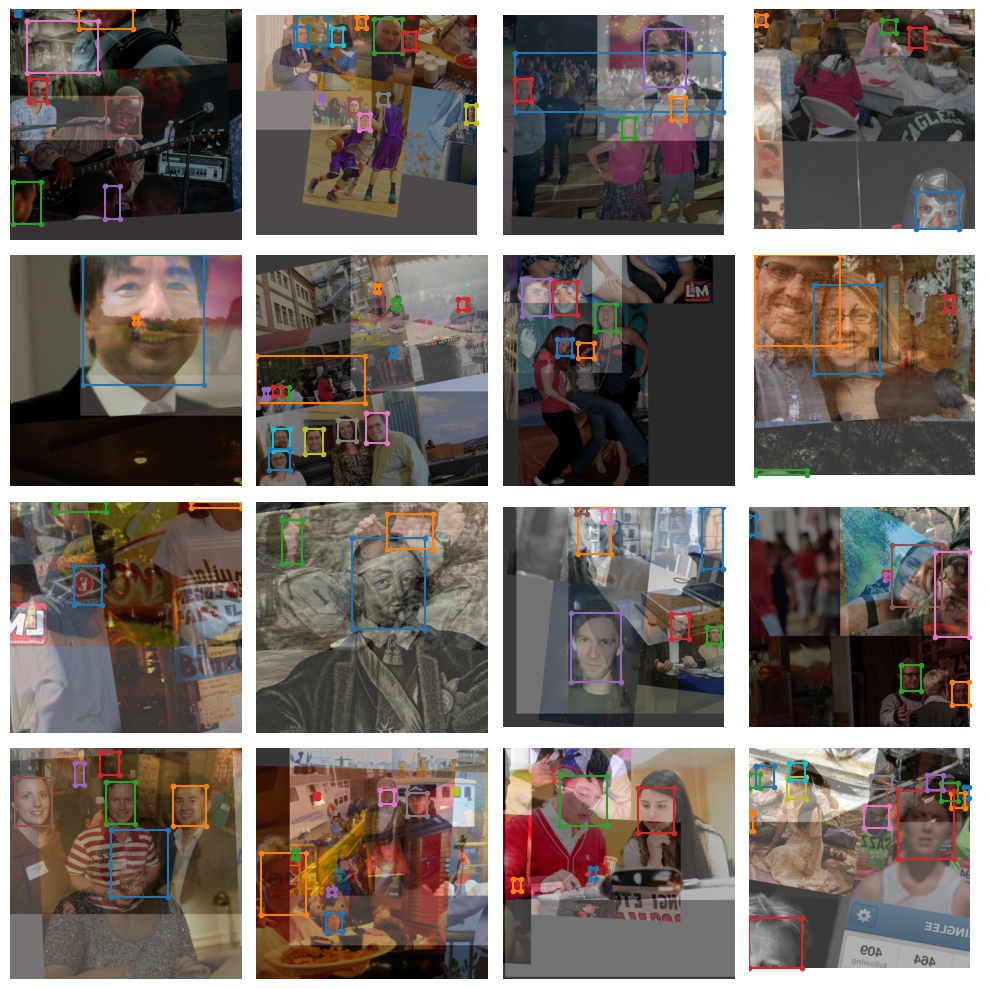

In [9]:
train_data.dataset.plot()

In [10]:
model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    pretrained_weights="coco"
)

[2023-11-29 18:41:42] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_l_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_l_coco.pth
100%|██████████| 256M/256M [00:09<00:00, 27.2MB/s]
[2023-11-29 18:41:52] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_l


In [11]:
# Ajustando a taxa de aprendizado inicial e outros parâmetros de otimização
train_params = {
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "LinearBatchLRWarmup",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4, # aumentei
    "lr_mode": "CosineLRScheduler",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "AdamW",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9999, "decay_type": "exp", "beta": 15}, # Ajustei parâmetros do EMA para EXP
    "max_epochs": MAX_EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16
        ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.5, # # Reduzi a threshold do NMS para uma detecção mais suave e aumentar a detecção de objetos menores


            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}



In [12]:
trainer = Trainer(experiment_name=EXPERIMENT_NAME, ckpt_root_dir=CHECKPOINT_DIR)


In [13]:
try:
    trainer.train(model=model,
              training_params=train_params,
              train_loader=train_data,
              valid_loader=val_data)
except Exception as e:
    print(f"Ocorreu um erro durante o treinamento: {e}")

[2023-11-29 18:42:13] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20231129_184213_737548`
[2023-11-29 18:42:13] INFO - sg_trainer.py - Checkpoints directory: /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548
[2023-11-29 18:42:13] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9999, 'decay_type': 'exp', 'beta': 15}


The console stream is now moved to /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/console_Nov29_18_42_13.txt


[2023-11-29 18:42:23] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Full dataset size:            1113       (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         69         (len(train_loader))
    - Gradient updates per epoch:   69         (len(train_loader) / batch_accumulate)
    - Model: YoloNAS_L  (66.91M parameters, 66.91M optimized)
    - Learning Rates and Weight Decays:
      - default: (66.91M parameters). LR: 0.0005 (66.91M parameters) WD: 0.0, (84.69K parameters), WD: 0.0001, (66.82M parameters)

[2023-11-29 18:42:23] INFO - sg_trainer.py - Started training for 1

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1517
│   ├── Ppyoloeloss/loss_iou = 0.7014
│   ├── Ppyoloeloss/loss_dfl = 0.688
│   └── Ppyoloeloss/loss = 2.541
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.4351
    ├── Ppyoloeloss/loss_iou = 0.6145
    ├── Ppyoloeloss/loss_dfl = 0.6192
    ├── Ppyoloeloss/loss = 2.6688
    ├── Precision@0.50 = 0.0211
    ├── Recall@0.50 = 0.7201
    ├── Map@0.50 = 0.4453
    └── F1@0.50 = 0.0411



Validating epoch 1: 100%|██████████| 36/36 [00:27<00:00,  1.29it/s]
[2023-11-29 18:49:11] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 18:49:11] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6605827212333679


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9812
│   │   ├── Epoch N-1      = 1.1517 (↘ -0.1705)
│   │   └── Best until now = 1.1517 (↘ -0.1705)
│   ├── Ppyoloeloss/loss_iou = 0.5998
│   │   ├── Epoch N-1      = 0.7014 (↘ -0.1015)
│   │   └── Best until now = 0.7014 (↘ -0.1015)
│   ├── Ppyoloeloss/loss_dfl = 0.5935
│   │   ├── Epoch N-1      = 0.688  (↘ -0.0944)
│   │   └── Best until now = 0.688  (↘ -0.0944)
│   └── Ppyoloeloss/loss = 2.1745
│       ├── Epoch N-1      = 2.541  (↘ -0.3664)
│       └── Best until now = 2.541  (↘ -0.3664)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8814
    │   ├── Epoch N-1      = 1.4351 (↘ -0.5537)
    │   └── Best until now = 1.4351 (↘ -0.5537)
    ├── Ppyoloeloss/loss_iou = 0.5139
    │   ├── Epoch N-1      = 0.6145 (↘ -0.1006)
    │   └── Best until now = 0.6145 (↘ -0.1006)
    ├── Ppyoloeloss/loss_dfl = 0.5194
    │   ├── Epoch N-1      = 0.6192 (↘ -0.0998)
    │   └── Best until now = 0.6192 (↘ -0.0998)
    ├── Ppyoloeloss/lo

Validating epoch 2: 100%|██████████| 36/36 [00:26<00:00,  1.36it/s]
[2023-11-29 18:52:28] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 18:52:28] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7146696448326111


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9196
│   │   ├── Epoch N-1      = 0.9812 (↘ -0.0616)
│   │   └── Best until now = 0.9812 (↘ -0.0616)
│   ├── Ppyoloeloss/loss_iou = 0.5742
│   │   ├── Epoch N-1      = 0.5998 (↘ -0.0257)
│   │   └── Best until now = 0.5998 (↘ -0.0257)
│   ├── Ppyoloeloss/loss_dfl = 0.5616
│   │   ├── Epoch N-1      = 0.5935 (↘ -0.0319)
│   │   └── Best until now = 0.5935 (↘ -0.0319)
│   └── Ppyoloeloss/loss = 2.0554
│       ├── Epoch N-1      = 2.1745 (↘ -0.1191)
│       └── Best until now = 2.1745 (↘ -0.1191)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8531
    │   ├── Epoch N-1      = 0.8814 (↘ -0.0283)
    │   └── Best until now = 0.8814 (↘ -0.0283)
    ├── Ppyoloeloss/loss_iou = 0.4958
    │   ├── Epoch N-1      = 0.5139 (↘ -0.0181)
    │   └── Best until now = 0.5139 (↘ -0.0181)
    ├── Ppyoloeloss/loss_dfl = 0.5023
    │   ├── Epoch N-1      = 0.5194 (↘ -0.0171)
    │   └── Best until now = 0.5194 (↘ -0.0171)
    ├── Ppyoloeloss/lo

Validating epoch 3: 100%|██████████| 36/36 [00:27<00:00,  1.29it/s]
[2023-11-29 18:55:46] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 18:55:46] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7358208298683167


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9079
│   │   ├── Epoch N-1      = 0.9196 (↘ -0.0117)
│   │   └── Best until now = 0.9196 (↘ -0.0117)
│   ├── Ppyoloeloss/loss_iou = 0.5691
│   │   ├── Epoch N-1      = 0.5742 (↘ -0.005)
│   │   └── Best until now = 0.5742 (↘ -0.005)
│   ├── Ppyoloeloss/loss_dfl = 0.5648
│   │   ├── Epoch N-1      = 0.5616 (↗ 0.0031)
│   │   └── Best until now = 0.5616 (↗ 0.0031)
│   └── Ppyoloeloss/loss = 2.0419
│       ├── Epoch N-1      = 2.0554 (↘ -0.0136)
│       └── Best until now = 2.0554 (↘ -0.0136)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8357
    │   ├── Epoch N-1      = 0.8531 (↘ -0.0174)
    │   └── Best until now = 0.8531 (↘ -0.0174)
    ├── Ppyoloeloss/loss_iou = 0.4866
    │   ├── Epoch N-1      = 0.4958 (↘ -0.0092)
    │   └── Best until now = 0.4958 (↘ -0.0092)
    ├── Ppyoloeloss/loss_dfl = 0.4952
    │   ├── Epoch N-1      = 0.5023 (↘ -0.0071)
    │   └── Best until now = 0.5023 (↘ -0.0071)
    ├── Ppyoloeloss/loss =

Validating epoch 4: 100%|██████████| 36/36 [00:28<00:00,  1.25it/s]
[2023-11-29 18:59:25] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 18:59:25] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7413026690483093


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8876
│   │   ├── Epoch N-1      = 0.9079 (↘ -0.0204)
│   │   └── Best until now = 0.9079 (↘ -0.0204)
│   ├── Ppyoloeloss/loss_iou = 0.5513
│   │   ├── Epoch N-1      = 0.5691 (↘ -0.0179)
│   │   └── Best until now = 0.5691 (↘ -0.0179)
│   ├── Ppyoloeloss/loss_dfl = 0.5478
│   │   ├── Epoch N-1      = 0.5648 (↘ -0.017)
│   │   └── Best until now = 0.5616 (↘ -0.0139)
│   └── Ppyoloeloss/loss = 1.9866
│       ├── Epoch N-1      = 2.0419 (↘ -0.0553)
│       └── Best until now = 2.0419 (↘ -0.0553)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8299
    │   ├── Epoch N-1      = 0.8357 (↘ -0.0058)
    │   └── Best until now = 0.8357 (↘ -0.0058)
    ├── Ppyoloeloss/loss_iou = 0.484
    │   ├── Epoch N-1      = 0.4866 (↘ -0.0026)
    │   └── Best until now = 0.4866 (↘ -0.0026)
    ├── Ppyoloeloss/loss_dfl = 0.493
    │   ├── Epoch N-1      = 0.4952 (↘ -0.0022)
    │   └── Best until now = 0.4952 (↘ -0.0022)
    ├── Ppyoloeloss/loss 

Validating epoch 5: 100%|██████████| 36/36 [00:27<00:00,  1.31it/s]
[2023-11-29 19:02:59] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 19:02:59] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7424403429031372


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8545
│   │   ├── Epoch N-1      = 0.8876 (↘ -0.0331)
│   │   └── Best until now = 0.8876 (↘ -0.0331)
│   ├── Ppyoloeloss/loss_iou = 0.5367
│   │   ├── Epoch N-1      = 0.5513 (↘ -0.0146)
│   │   └── Best until now = 0.5513 (↘ -0.0146)
│   ├── Ppyoloeloss/loss_dfl = 0.5284
│   │   ├── Epoch N-1      = 0.5478 (↘ -0.0193)
│   │   └── Best until now = 0.5478 (↘ -0.0193)
│   └── Ppyoloeloss/loss = 1.9196
│       ├── Epoch N-1      = 1.9866 (↘ -0.067)
│       └── Best until now = 1.9866 (↘ -0.067)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8273
    │   ├── Epoch N-1      = 0.8299 (↘ -0.0026)
    │   └── Best until now = 0.8299 (↘ -0.0026)
    ├── Ppyoloeloss/loss_iou = 0.483
    │   ├── Epoch N-1      = 0.484  (↘ -0.0011)
    │   └── Best until now = 0.484  (↘ -0.0011)
    ├── Ppyoloeloss/loss_dfl = 0.4919
    │   ├── Epoch N-1      = 0.493  (↘ -0.0011)
    │   └── Best until now = 0.493  (↘ -0.0011)
    ├── Ppyoloeloss/loss 

Validating epoch 6: 100%|██████████| 36/36 [00:28<00:00,  1.27it/s]
[2023-11-29 19:06:38] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 19:06:38] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7431853413581848


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8444
│   │   ├── Epoch N-1      = 0.8545 (↘ -0.01)
│   │   └── Best until now = 0.8545 (↘ -0.01)
│   ├── Ppyoloeloss/loss_iou = 0.526
│   │   ├── Epoch N-1      = 0.5367 (↘ -0.0106)
│   │   └── Best until now = 0.5367 (↘ -0.0106)
│   ├── Ppyoloeloss/loss_dfl = 0.5283
│   │   ├── Epoch N-1      = 0.5284 (↘ -1e-04)
│   │   └── Best until now = 0.5284 (↘ -1e-04)
│   └── Ppyoloeloss/loss = 1.8988
│       ├── Epoch N-1      = 1.9196 (↘ -0.0208)
│       └── Best until now = 1.9196 (↘ -0.0208)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8259
    │   ├── Epoch N-1      = 0.8273 (↘ -0.0014)
    │   └── Best until now = 0.8273 (↘ -0.0014)
    ├── Ppyoloeloss/loss_iou = 0.4824
    │   ├── Epoch N-1      = 0.483  (↘ -0.0005)
    │   └── Best until now = 0.483  (↘ -0.0005)
    ├── Ppyoloeloss/loss_dfl = 0.4912
    │   ├── Epoch N-1      = 0.4919 (↘ -0.0006)
    │   └── Best until now = 0.4919 (↘ -0.0006)
    ├── Ppyoloeloss/loss = 1.

Validating epoch 7: 100%|██████████| 36/36 [00:27<00:00,  1.33it/s]
[2023-11-29 19:10:21] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 19:10:21] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7436860203742981


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8179
│   │   ├── Epoch N-1      = 0.8444 (↘ -0.0265)
│   │   └── Best until now = 0.8444 (↘ -0.0265)
│   ├── Ppyoloeloss/loss_iou = 0.5088
│   │   ├── Epoch N-1      = 0.526  (↘ -0.0172)
│   │   └── Best until now = 0.526  (↘ -0.0172)
│   ├── Ppyoloeloss/loss_dfl = 0.5055
│   │   ├── Epoch N-1      = 0.5283 (↘ -0.0228)
│   │   └── Best until now = 0.5283 (↘ -0.0228)
│   └── Ppyoloeloss/loss = 1.8322
│       ├── Epoch N-1      = 1.8988 (↘ -0.0666)
│       └── Best until now = 1.8988 (↘ -0.0666)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8249
    │   ├── Epoch N-1      = 0.8259 (↘ -0.001)
    │   └── Best until now = 0.8259 (↘ -0.001)
    ├── Ppyoloeloss/loss_iou = 0.4821
    │   ├── Epoch N-1      = 0.4824 (↘ -0.0003)
    │   └── Best until now = 0.4824 (↘ -0.0003)
    ├── Ppyoloeloss/loss_dfl = 0.4908
    │   ├── Epoch N-1      = 0.4912 (↘ -0.0004)
    │   └── Best until now = 0.4912 (↘ -0.0004)
    ├── Ppyoloeloss/loss

Validating epoch 8: 100%|██████████| 36/36 [00:28<00:00,  1.24it/s]
[2023-11-29 19:14:26] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 19:14:26] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7446462512016296


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8033
│   │   ├── Epoch N-1      = 0.8179 (↘ -0.0146)
│   │   └── Best until now = 0.8179 (↘ -0.0146)
│   ├── Ppyoloeloss/loss_iou = 0.5
│   │   ├── Epoch N-1      = 0.5088 (↘ -0.0088)
│   │   └── Best until now = 0.5088 (↘ -0.0088)
│   ├── Ppyoloeloss/loss_dfl = 0.5055
│   │   ├── Epoch N-1      = 0.5055 (↗ 0.0)
│   │   └── Best until now = 0.5055 (↗ 0.0)
│   └── Ppyoloeloss/loss = 1.8089
│       ├── Epoch N-1      = 1.8322 (↘ -0.0233)
│       └── Best until now = 1.8322 (↘ -0.0233)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8242
    │   ├── Epoch N-1      = 0.8249 (↘ -0.0007)
    │   └── Best until now = 0.8249 (↘ -0.0007)
    ├── Ppyoloeloss/loss_iou = 0.4818
    │   ├── Epoch N-1      = 0.4821 (↘ -0.0002)
    │   └── Best until now = 0.4821 (↘ -0.0002)
    ├── Ppyoloeloss/loss_dfl = 0.4905
    │   ├── Epoch N-1      = 0.4908 (↘ -0.0003)
    │   └── Best until now = 0.4908 (↘ -0.0003)
    ├── Ppyoloeloss/loss = 1.7965

Validating epoch 9: 100%|██████████| 36/36 [00:28<00:00,  1.28it/s]
[2023-11-29 19:18:33] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231129_184213_737548/ckpt_best.pth
[2023-11-29 19:18:34] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7453920841217041


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8075
│   │   ├── Epoch N-1      = 0.8033 (↗ 0.0042)
│   │   └── Best until now = 0.8033 (↗ 0.0042)
│   ├── Ppyoloeloss/loss_iou = 0.4949
│   │   ├── Epoch N-1      = 0.5    (↘ -0.0051)
│   │   └── Best until now = 0.5    (↘ -0.0051)
│   ├── Ppyoloeloss/loss_dfl = 0.4996
│   │   ├── Epoch N-1      = 0.5055 (↘ -0.006)
│   │   └── Best until now = 0.5055 (↘ -0.0059)
│   └── Ppyoloeloss/loss = 1.802
│       ├── Epoch N-1      = 1.8089 (↘ -0.0069)
│       └── Best until now = 1.8089 (↘ -0.0069)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8234
    │   ├── Epoch N-1      = 0.8242 (↘ -0.0007)
    │   └── Best until now = 0.8242 (↘ -0.0007)
    ├── Ppyoloeloss/loss_iou = 0.4816
    │   ├── Epoch N-1      = 0.4818 (↘ -0.0002)
    │   └── Best until now = 0.4818 (↘ -0.0002)
    ├── Ppyoloeloss/loss_dfl = 0.4902
    │   ├── Epoch N-1      = 0.4905 (↘ -0.0003)
    │   └── Best until now = 0.4905 (↘ -0.0003)
    ├── Ppyoloeloss/loss =

[2023-11-29 19:20:22] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 10: 100%|██████████| 36/36 [00:27<00:00,  1.30it/s]


In [23]:
checkpoint_file = os.path.join(CHECKPOINT_DIR, EXPERIMENT_NAME, 'RUN_20231129_184213_737548/ckpt_best.pth')


In [26]:
if os.path.exists(checkpoint_file):
    best_model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    checkpoint_path=checkpoint_file
).to(DEVICE)
else:
    print(f"O arquivo de checkpoint não foi encontrado: {checkpoint_file}")

In [41]:
%load_ext tensorboard
%tensorboard --logdir {CHECKPOINT_DIR}/{EXPERIMENT_NAME}

Reusing TensorBoard on port 6006 (pid 19000), started 0:55:33 ago. (Use '!kill 19000' to kill it.)

<IPython.core.display.Javascript object>

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


[2023-11-29 19:35:05] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


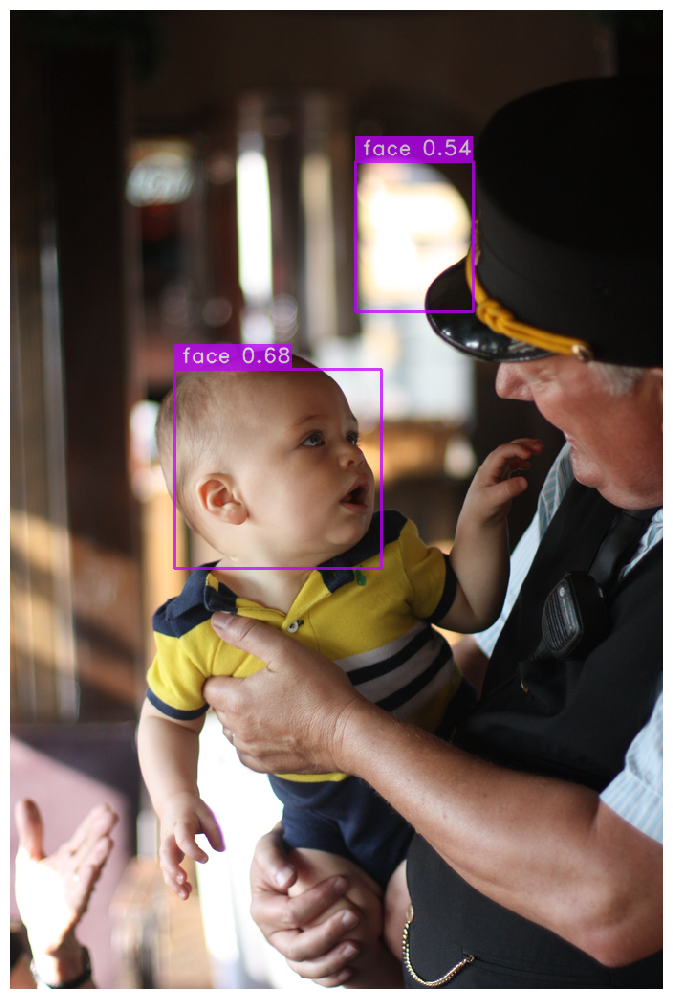

In [28]:
img_1 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/5a02a982ebece444.jpg"
best_model.predict(img_1).show()

[2023-11-29 19:35:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


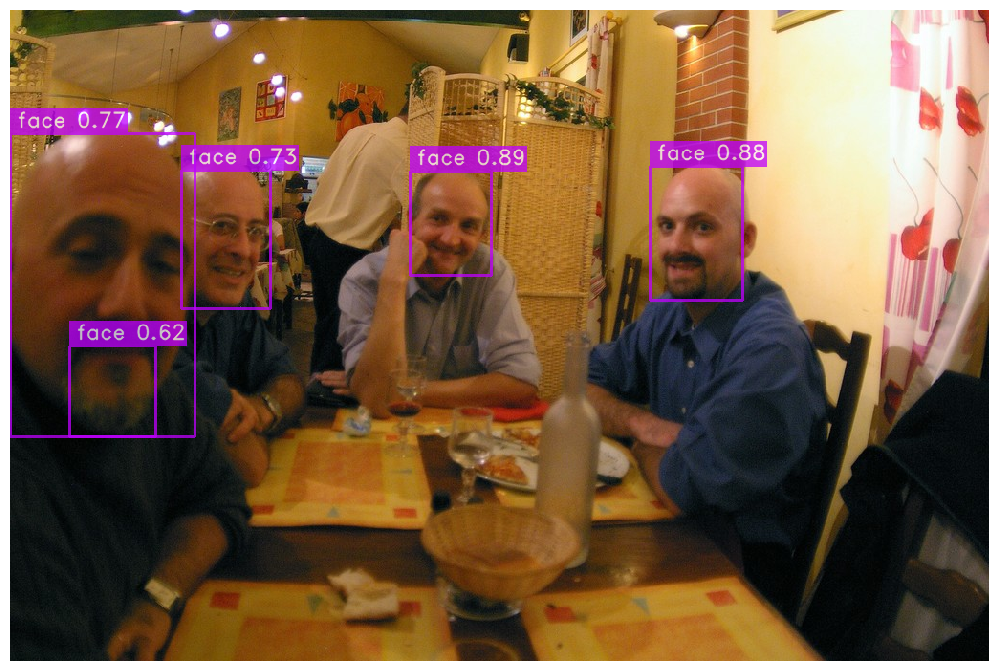

In [29]:
img_2 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/4fb5e4e5d4588fc0.jpg"
best_model.predict(img_2).show()

[2023-11-29 19:35:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


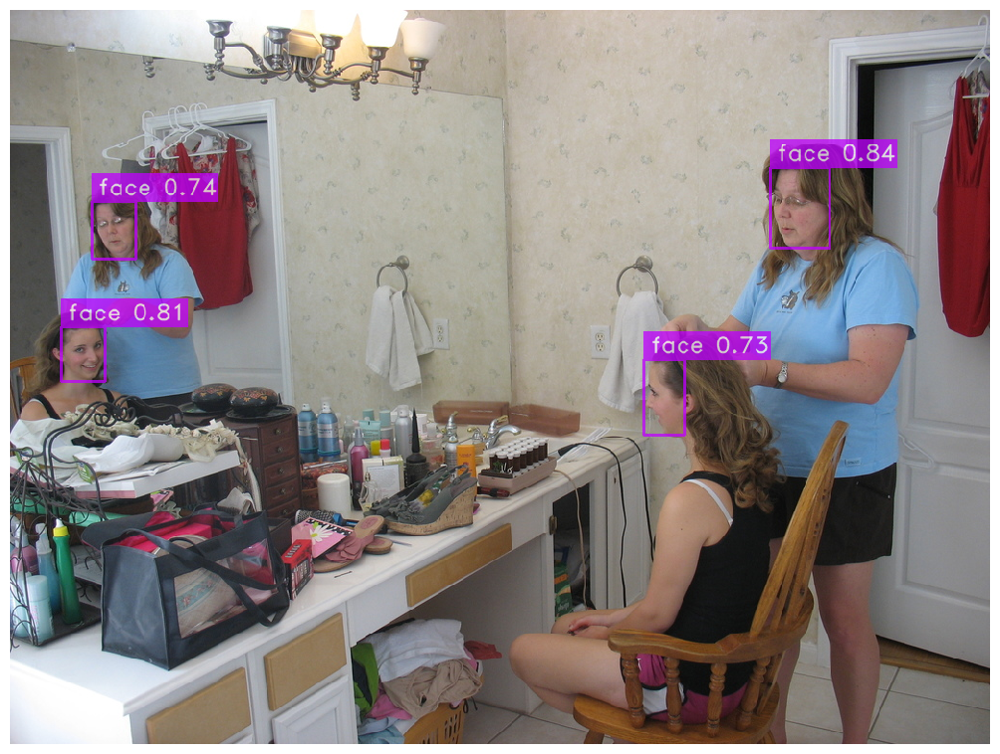

In [30]:
img_4 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/5ad0d0669d470598.jpg"
best_model.predict(img_4).show()

[2023-11-29 19:35:26] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


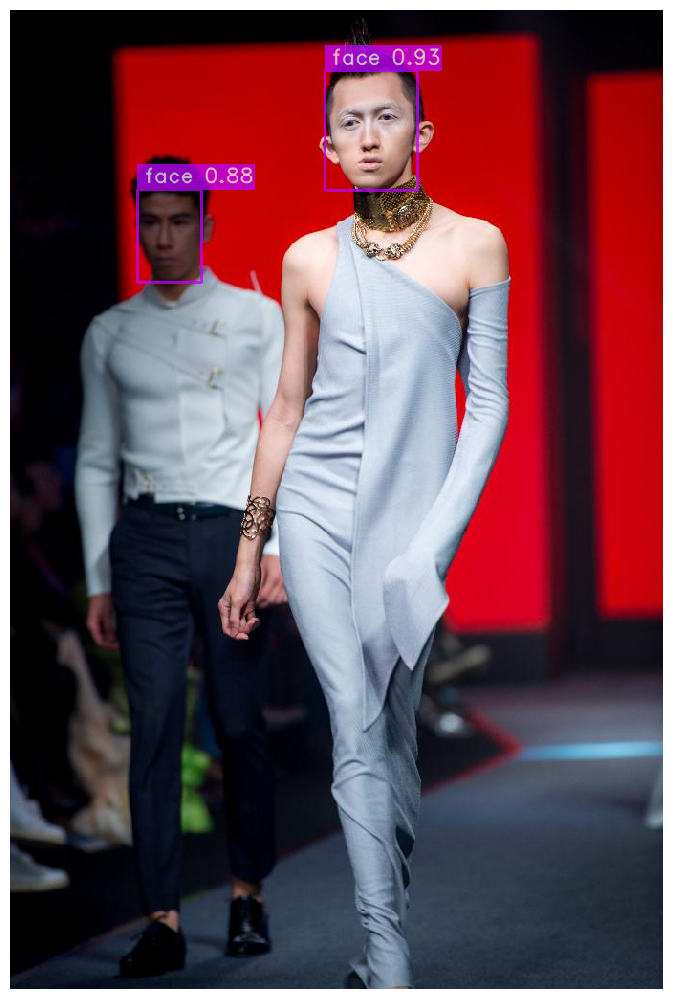

In [31]:
img_5 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/6fdd7c067aeb9952.jpg"
best_model.predict(img_5).show()

[2023-11-29 19:35:32] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


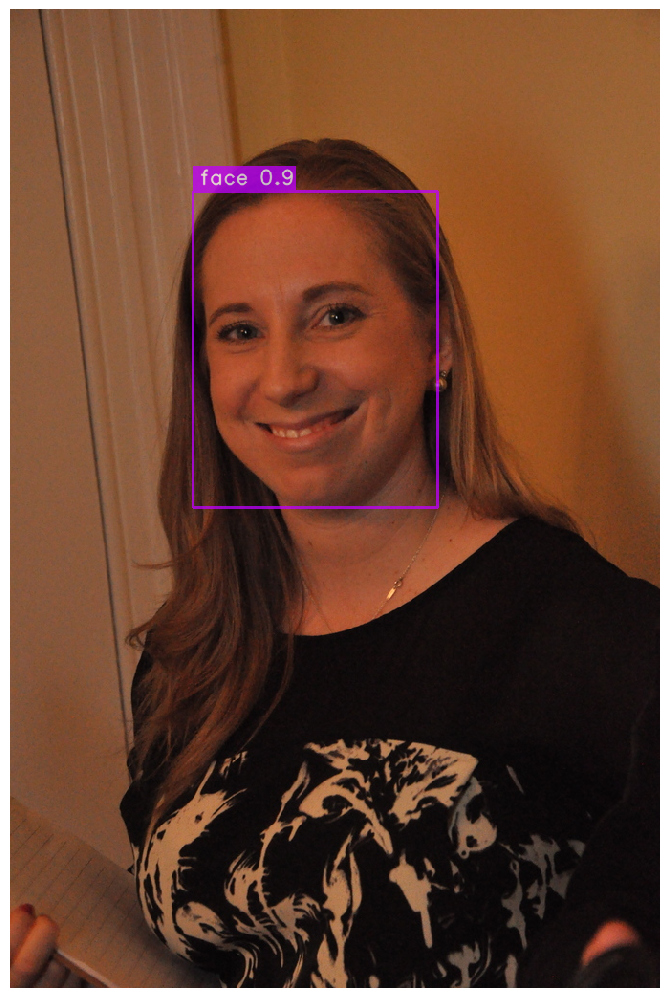

In [32]:
img_6 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/9feaa97f0a92eef6.jpg"
best_model.predict(img_6).show()

[2023-11-29 19:35:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


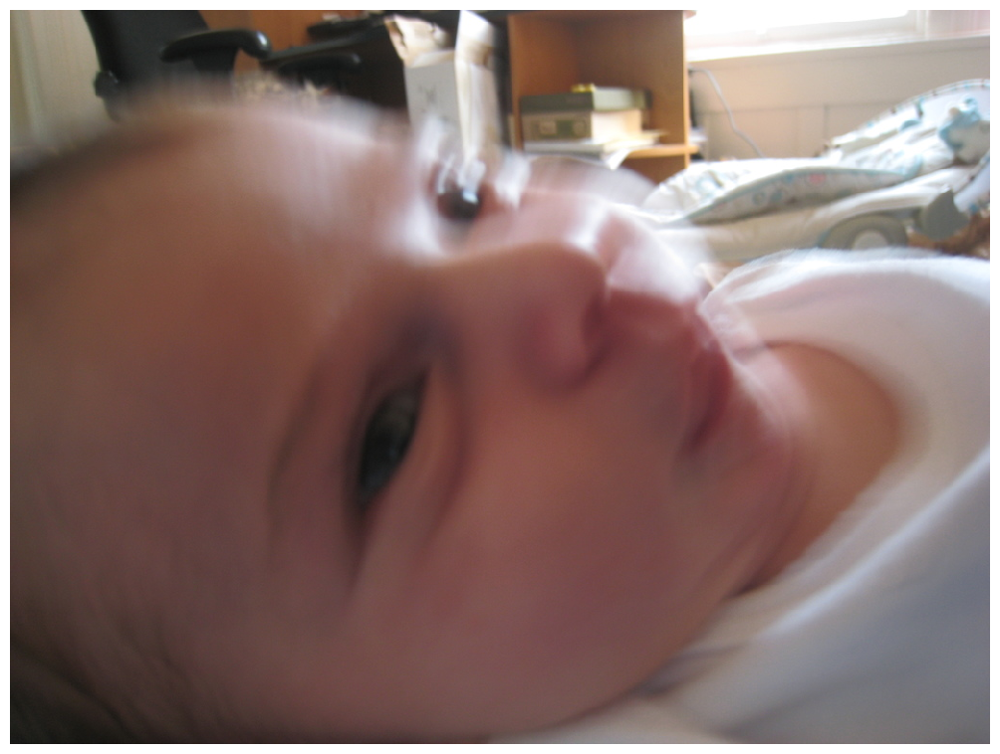

In [33]:
img_7 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/9fac74937dfdf802.jpg"
best_model.predict(img_7).show()


[2023-11-29 19:35:49] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


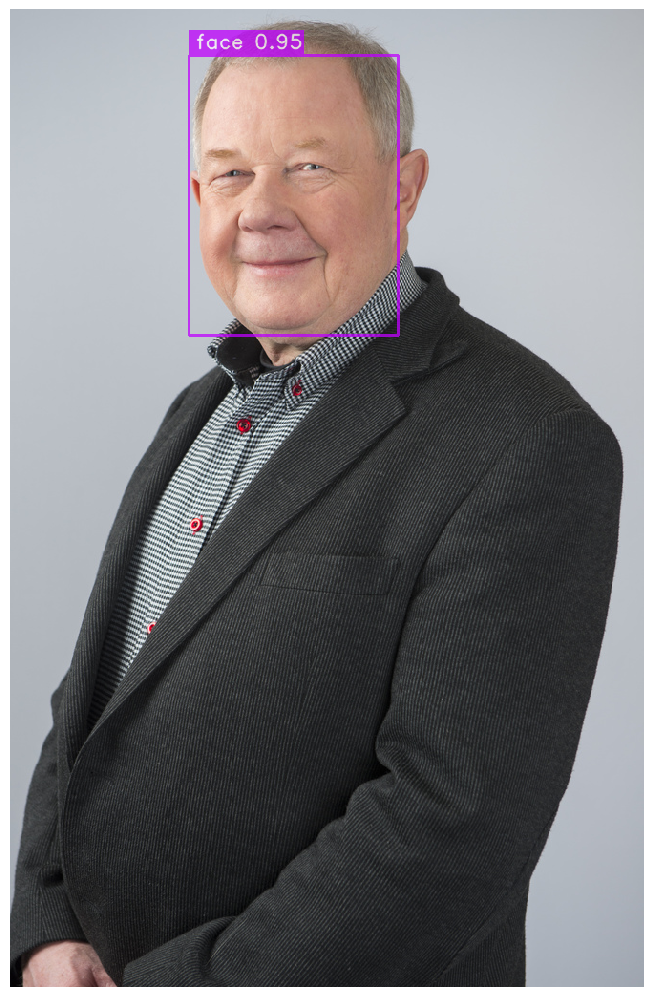

In [34]:
img_8 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/8ec3aa5cae0009ab.jpg"
best_model.predict(img_8).show()

[2023-11-29 19:35:56] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


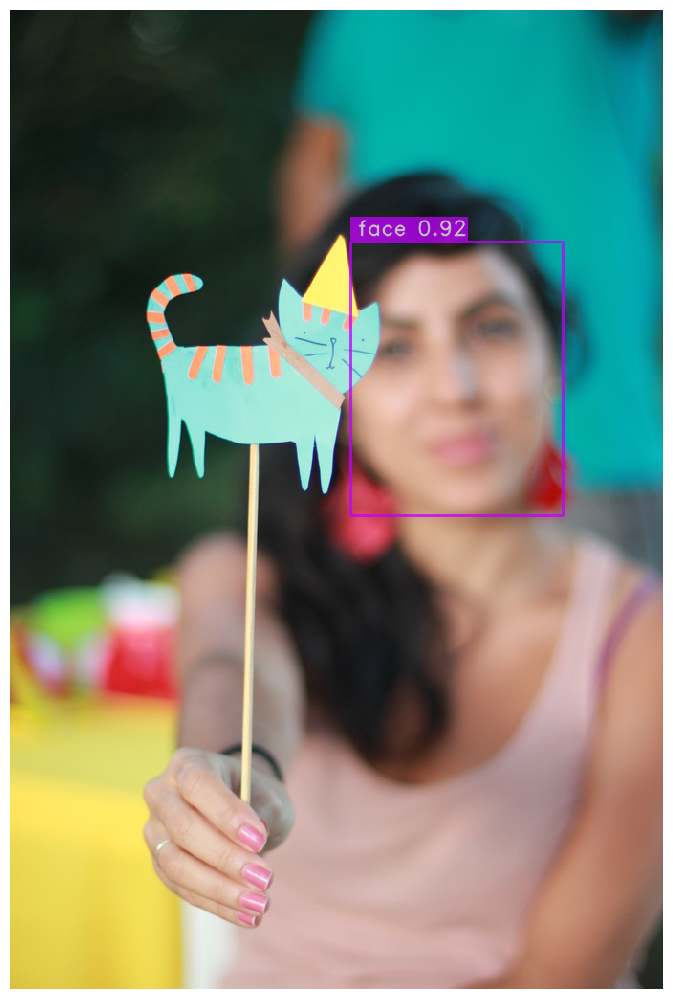

In [35]:
img_9 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/5f208999d992a82a.jpg"
best_model.predict(img_9).show()

[2023-11-29 19:36:03] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


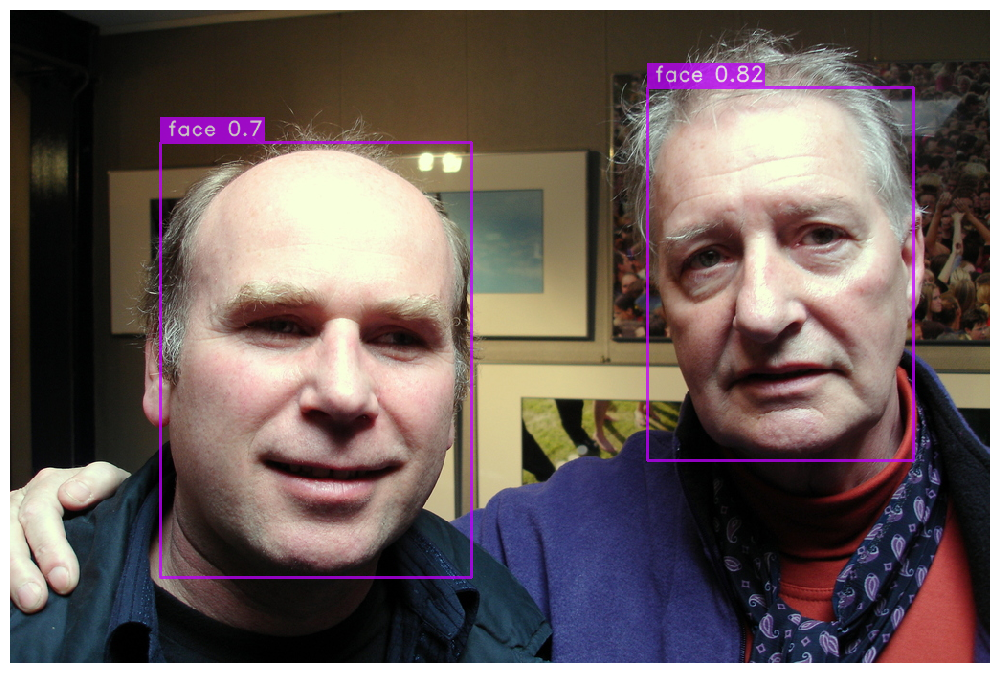

In [36]:
img_10 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/0007ad5c6245a41d.jpg"
best_model.predict(img_10).show()

[2023-11-29 19:45:03] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


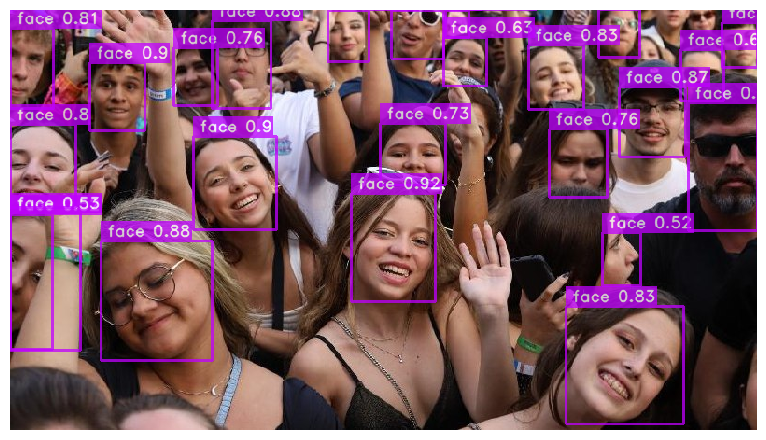

In [39]:
img_11 = "/content/drive/MyDrive/ae847b76-8c67-4cf0-8f62-72b231effbde.jpg"
best_model.predict(img_11).show()

[2023-11-29 19:48:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


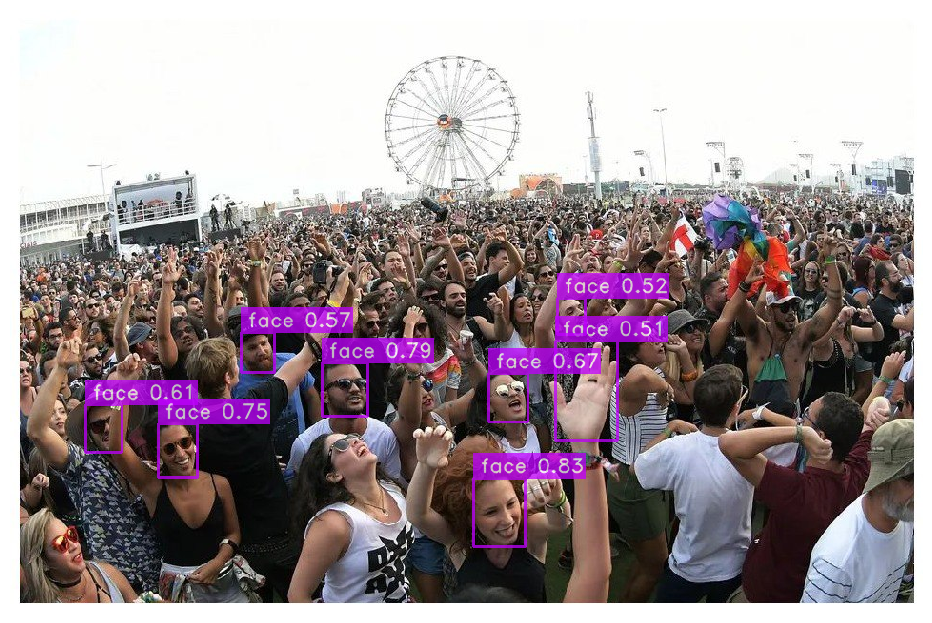

In [40]:
img_12 = "/content/drive/MyDrive/f71a22b2-fc41-4e8c-92e7-8e36763539e8.jpg"
best_model.predict(img_12).show()